In [1]:
cd F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R\

F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R


In [2]:
ls 

 驱动器 F 中的卷是 data
 卷的序列号是 6436-68F1

 F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R 的目录

2024/09/15  19:09    <DIR>          .
2024/09/15  19:09    <DIR>          ..
2024/03/13  17:01            32,070 1.pdf
2024/03/13  17:03           677,266 1.png
2024/04/05  19:28           632,764 1cross_macaque_mouse_mn_cluster_level.csv
2021/04/17  01:11             4,557 1v1_analysis.R
2024/04/05  19:28           868,056 1within_macaque_mn_cluster_level.csv
2024/04/05  19:28           880,845 1within_mouse_mn_cluster_level.csv
2023/05/26  16:16           535,702 704_TFS_COE.pdf
2023/08/17  17:43        16,668,064 A SINGLE-NULEUS TRANSCRIPTOMIC ATLAS OF HUMAN FETAL COCHLEA.ipynb
2024/03/18  20:13        21,646,159 adata_mac_HC.h5ad
2024/03/19  21:11            57,289 adata_mac_hc.rds
2024/03/20  11:14         1,380,678 adata_mac_hc2.loom
2024/04/05  16:58            31,592 anchors_for_cca_integration_macaque_coe.csv
2024/04/05  16:29            31,575 anchors_for_cca_integration_mouse_coe.csv


In [3]:
import scanpy as sc
sc.set_figure_params()
adata=sc.read_10x_h5("filtered_feature_bc_matrix_1Y.h5")

In [4]:
adata

AnnData object with n_obs × n_vars = 10501 × 33368
    var: 'gene_ids', 'feature_types', 'genome'

In [7]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [9]:
adata=sc.AnnData(adata.X,obs=adata.obs,var=adata.var)
adata.var["Gene"]=adata.var_names
adata.obs["CellID"]=adata.obs_names

In [ ]:
from scFates.tools.utils import ProgressParallel
from joblib import delayed

Finding overdispersed features
    computing mean and variances
    gam fitting


G:\Miniconda3\envs\scFates\lib\site-packages\rpy2\robjects\pandas2ri.py:55: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for name, values in obj.iteritems():


    found 2318 over-dispersed features (0:00:01) --> added 
    .var['res'], residuals of GAM fit.
    .var['lp'], p-value.
    .var['lpa'], BH adjusted p-value.
    .var['qv'], percentile of qui-squared distribution.
    .var['highly_variable'], feature is over-dispersed.



G:\Miniconda3\envs\scFates\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
G:\Miniconda3\envs\scFates\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
G:\Miniconda3\envs\scFates\lib\site-packages\umap\distances.py:1086: NumbaDeprecationWarning: The 'nopython'

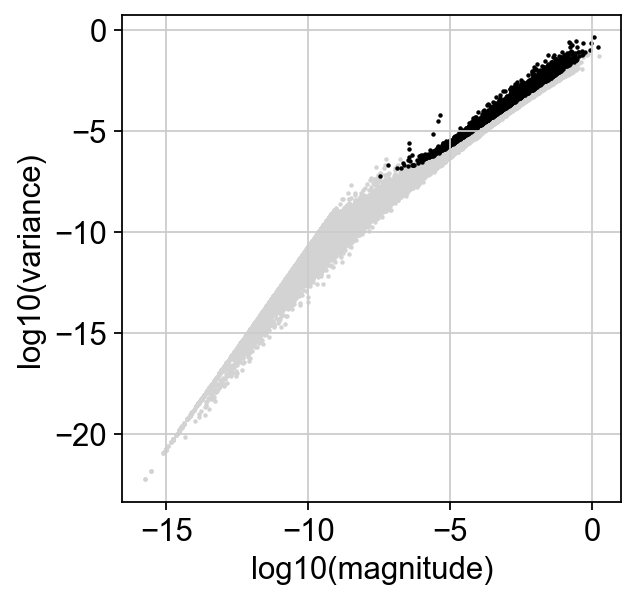

In [12]:
sc.set_figure_params()
import scFates as scf
sc.pp.filter_genes(adata,min_cells=1)
sc.pp.normalize_total(adata, target_sum=1e3)
sc.pp.log1p(adata)
scf.pp.find_overdispersed(adata,plot=True,)
adata.layers["scaled"]=sc.pp.scale(adata.X,max_value=10,copy=True)
adata.obsm["X_pca"]=sc.pp.pca(adata[:,adata.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata,n_neighbors=200,n_pcs=50,metric="cosine")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


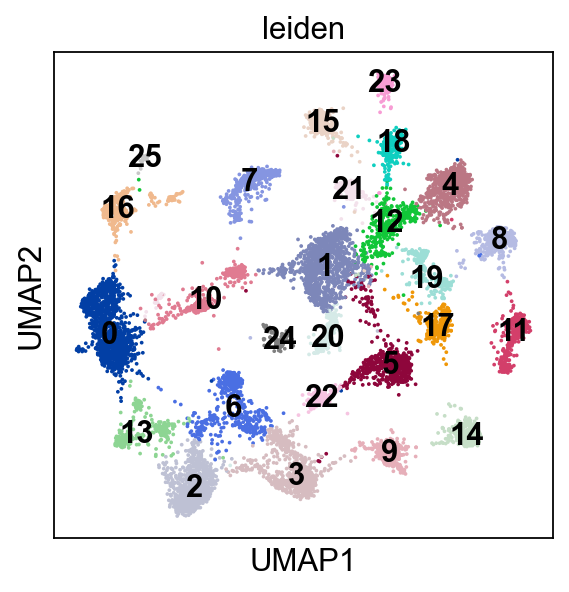

In [13]:
sc.tl.umap(adata)
sc.tl.leiden(adata)
sc.pl.umap(adata,color=["leiden"],legend_loc="on data")

In [14]:
adata.obsm["X_pca"].shape

(10501, 50)

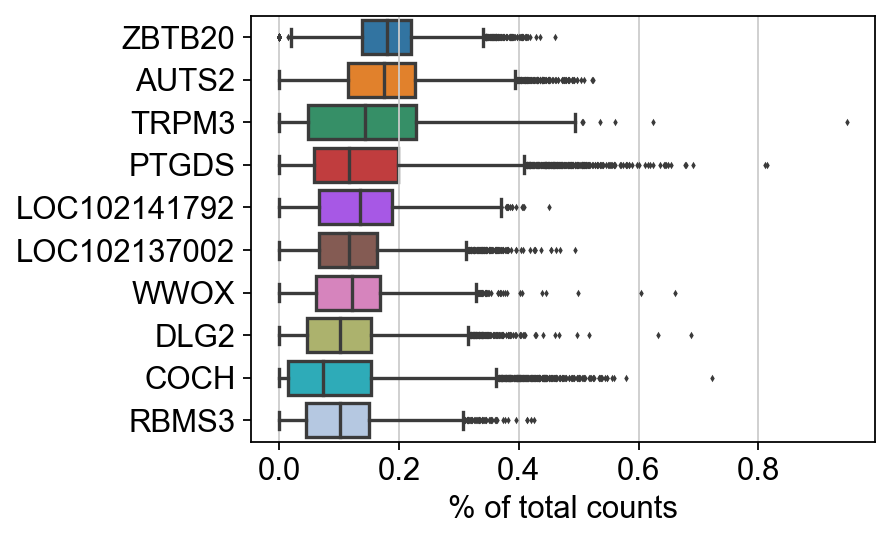

In [15]:
sc.pl.highest_expr_genes(adata, n_top=10, )

In [36]:
adata.var['Hb'] = adata.var_names.str.startswith('Hb-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['Hb'], percent_top=None, log1p=False, inplace=True)

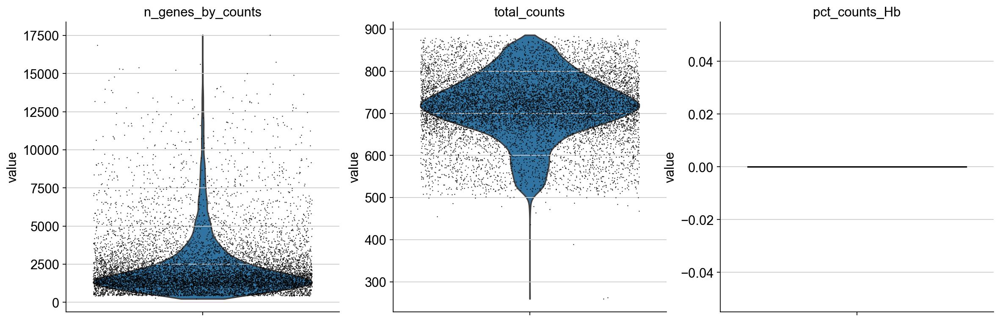

In [37]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_Hb'],
             jitter=0.4, multi_panel=True)

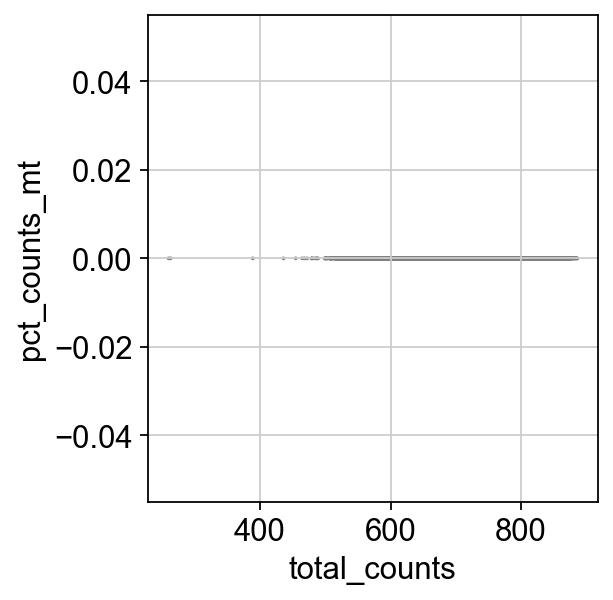

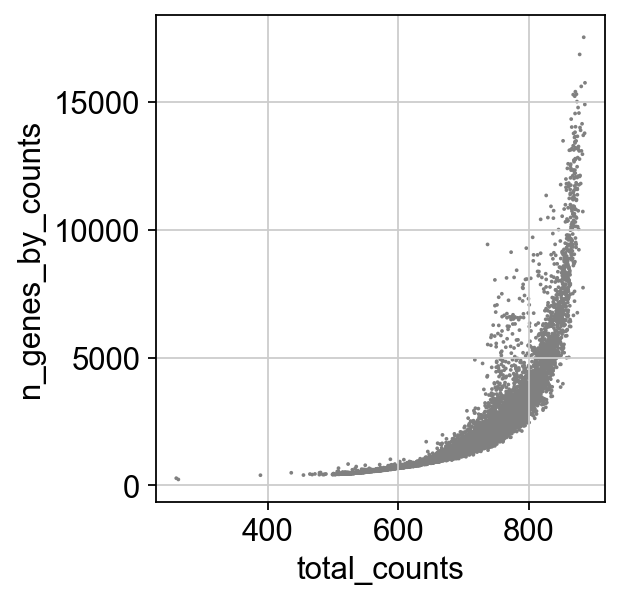

In [38]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

<Axes: xlabel='total_counts', ylabel='n_genes_by_counts'>

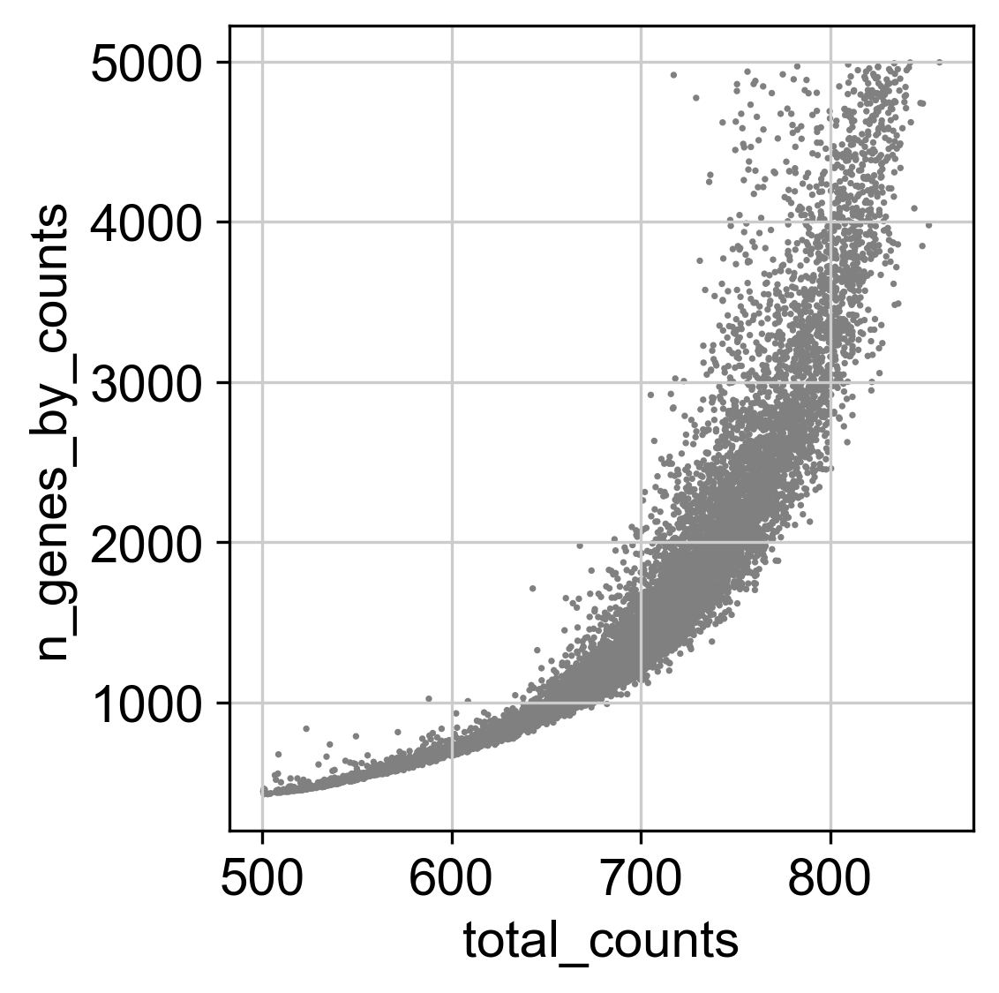

In [386]:
#import matplotlib.pyplot as plt
n_genes_filter = 5000
n_counts_filter = 500
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', show = False)



In [41]:
adata = adata[adata.obs.n_genes_by_counts < 5000, :]
adata = adata[adata.obs.total_counts > 500, :]

In [42]:
adata

View of AnnData object with n_obs × n_vars = 9596 × 25972
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [43]:
sc.pp.normalize_total(adata, target_sum=1e4)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [44]:
sc.pp.log1p(adata)

In [45]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

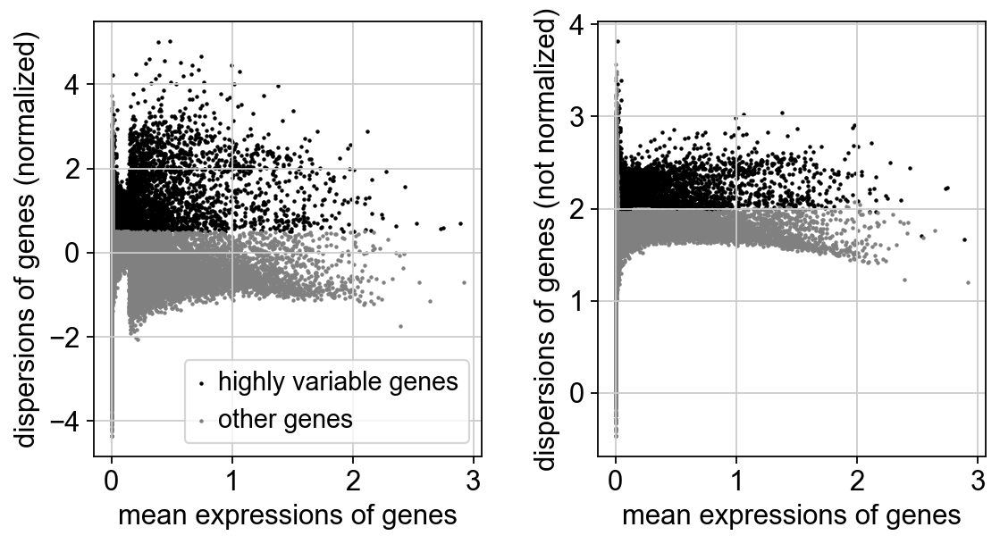

In [46]:
sc.pl.highly_variable_genes(adata)

In [47]:
adata.raw = adata

In [48]:
adata = adata[:, adata.var.highly_variable]

In [49]:
adata

View of AnnData object with n_obs × n_vars = 9596 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg'
    obsm: 'X_pca', 'X_umap'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [51]:
sc.pp.regress_out(adata, ['total_counts'])

In [52]:
sc.pp.scale(adata, max_value=10)

In [56]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=100)

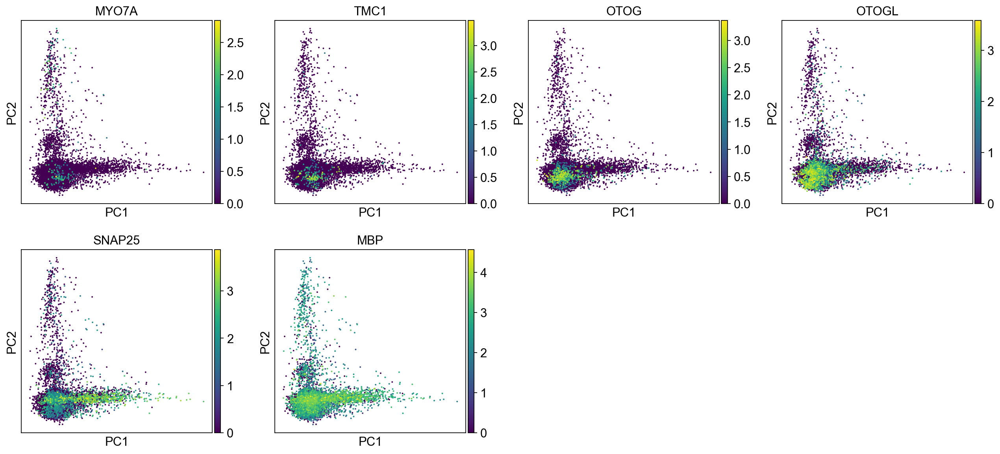

In [57]:
sc.pl.pca(adata, color=['MYO7A','TMC1','OTOG','OTOGL','SNAP25','MBP' ] )

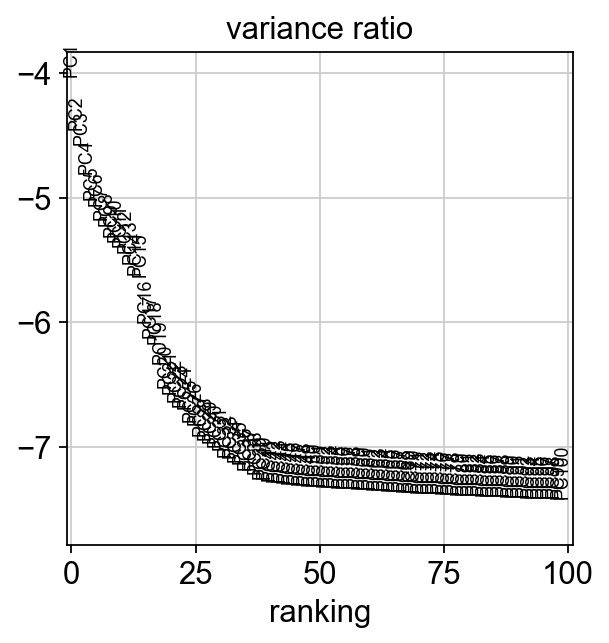

In [58]:
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=100)

In [65]:
adata.write("macaque_cochlea_1y.h5ad")

In [64]:
adata

AnnData object with n_obs × n_vars = 9596 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [104]:
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=100)
sc.tl.leiden(adata,resolution=2)
sc.tl.louvain(adata)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


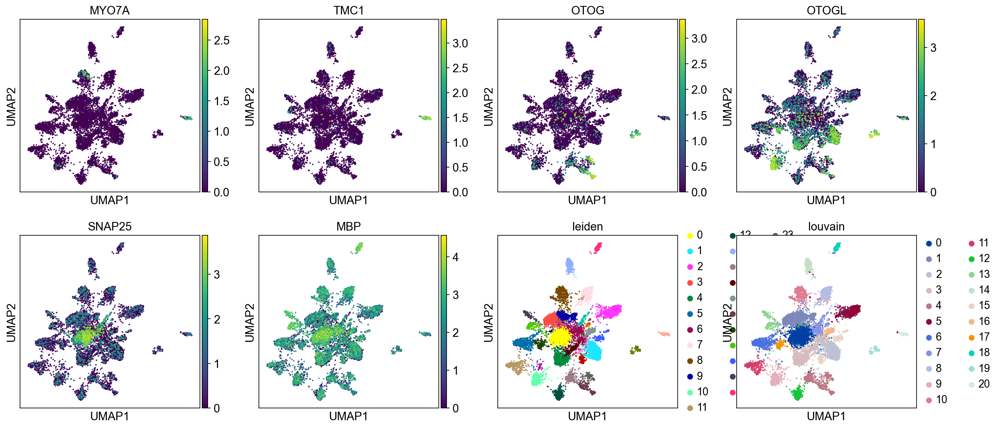

In [105]:
sc.pl.umap(adata, color=['MYO7A','TMC1','OTOG','OTOGL','SNAP25','MBP','leiden','louvain'])

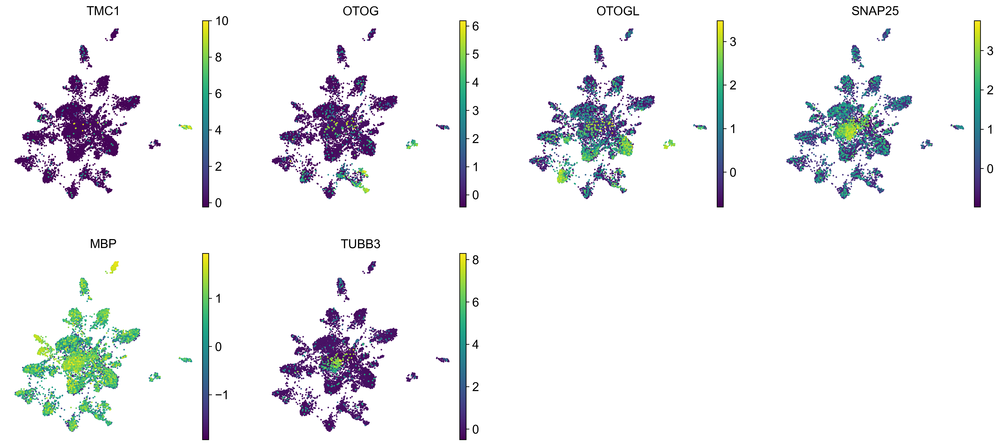

In [125]:
sc.pl.umap(adata, color=['TMC1','OTOG','OTOGL','SNAP25','MBP','TUBB3'], use_raw=False)

In [107]:
adata.write("macaque_cochlea_1y.h5ad")

In [416]:
import scanpy as sc
import scFates as scf
sc.set_figure_params()
macaque_cochlea_1y=sc.read("macaque_cochlea_1y.h5ad")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


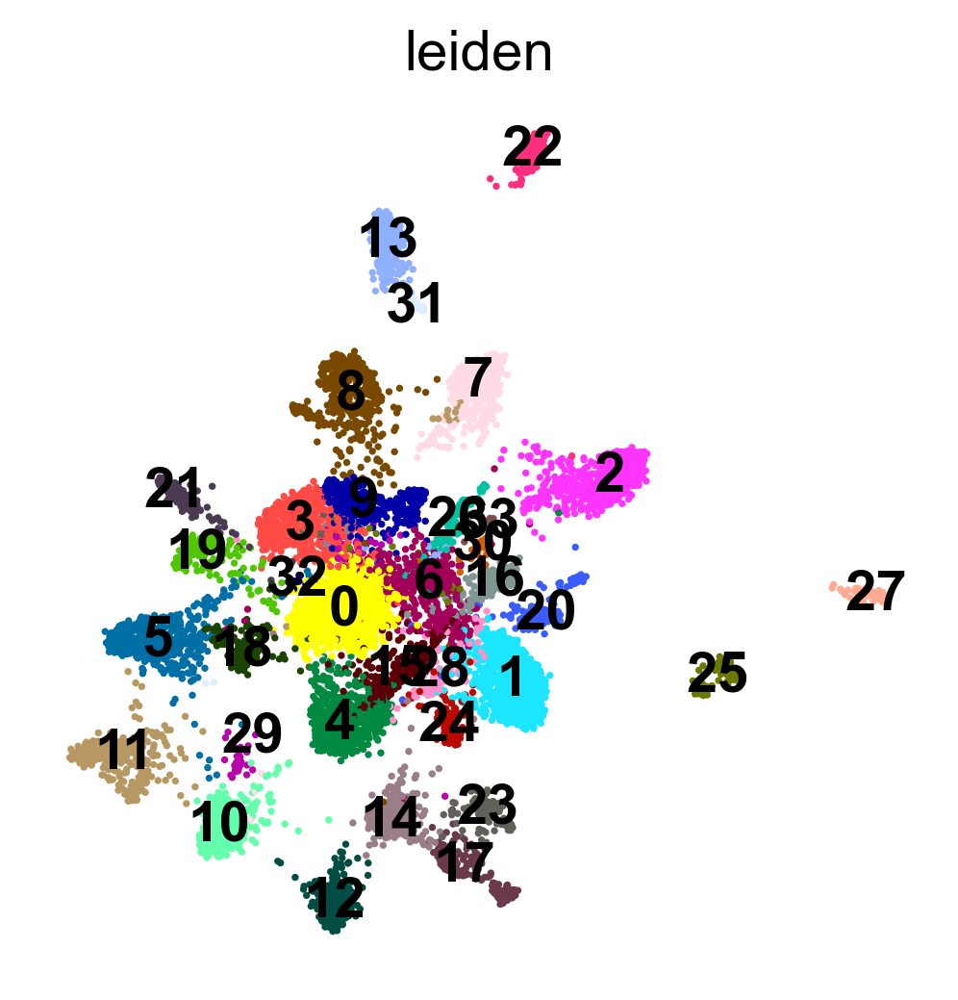

In [124]:
sc.pl.umap(adata, color=['leiden'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


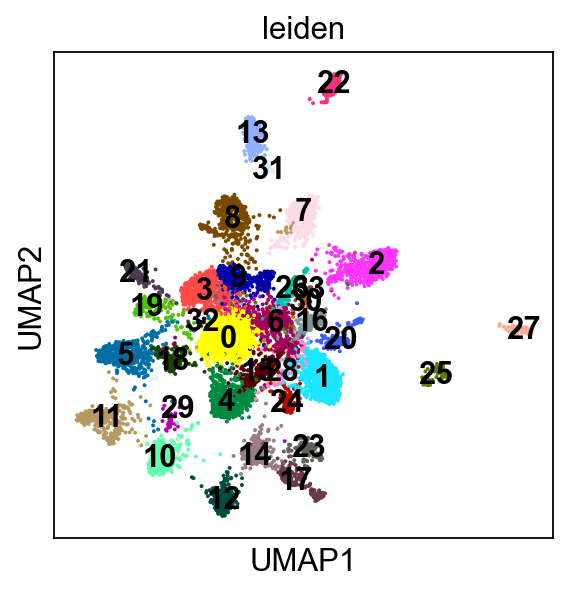

In [417]:
sc.pl.umap(macaque_cochlea_1y, color=['leiden'],legend_loc="on data")

In [418]:
marker_genes = [
    *["OTOA"], #INTERDENTAL CELLS
    *["TMC1","MYO7A","OTOF","SLC26A5","SLC17A8"],#HAIR CELLS
    *["OTOG","OTOGL","USH1C","GATA3","LGR5"],# SUPPORTING CELLS
    *["SMPX","LGR6","ENAH","NGFR","PROX1"],#PILLAR CELLS
    *["PRDM12","FGFR3"],#PILLAR CELLS, DEITERS' CELLS
    *["CEACAM16","RBP7","FABP3","S100A1"],#DEITERS' CELLS
    *["AQP4","TECTB","SLC1A3","APOE"],#INNER BOR.-PH./HENSEN'S CELLS
    *["EPYC"],#INNER BOR.-PH./HENSEN'S CELLS; CLAUD./IN.-OUT.SULCUS CELLS 
    *["EMILIN2","NOTUM","RARRES1"], #TYMPANIC BORDER CELLS
    
    *["SNAP25","NEFL","PVALB","TH","ANO2","TUBB3"],#SGN
    *["OLIG1","OLIG2"], #GLIAL PRECURSOR CELLS
    *["MAG","MOG","MOBP"],#SATELLITE GLIAL CELLS
    *["MPZ","PRX"], #SCHWANN CELLS
    *["MLANA"], #LW
    *["VWF"], #ENDO.CELLS
    *["ESAM"],#ENDO.CELLS
    *["RGS5","ITGA8","CREB5"],#PERICYTES
    *["TAGLN"],#SMOOTH MUSCLE CELLS (ALDN1A2)
    *["KCNE1","ESRRB","DCLK1"],#MARGINAL CELLS
    *["TYR","DCT"],#INTER.STRIA CELLS
    *["CLDN11","ATP6V0A4","TJP1"],#BASAL STRIA CELLS
    *["SLC26A4","ANXA1"],#SPINDLE CELLS; ROOT CELLS

    
    *["OTOS","COL9A2","COL9A3","ATP2B2","SLC13A3","SLC7A11","SLC4A10","VEPH1","CHST9","THSD4"],#FIBROCYTES
    *["SLC12A2","GJB2"],# FIBROCYTES SUBTYPES I TO V
    *["DLX5","BGLAP","PHEX", "DMP1","IBSP"], #OSTEOBLASTS
    *["OSR2","BMP6","SLC7A11"], # SURROUNDING STRUCTURES
    *["SLC26A7"], #RM
    
    #*["RHD"], #ERYTHROCYTES
    #*["LY6G"], #NEUTROPHILS
    *["CD19"], # B CELLS
    *["CD3G"], #T CELLS   
    *["NKG7"],  #NK CELLS
    *["CD68"], #MONOCYTES
    *["AIF1","CD163"],#MACROPHAGES 
    #*["PRSS34"]  #MAST CELLS 

    
]

In [3]:
sc.pl.dotplot(macaque_cochlea_1y, marker_genes, groupby="leiden");

NameError: name 'sc' is not defined

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


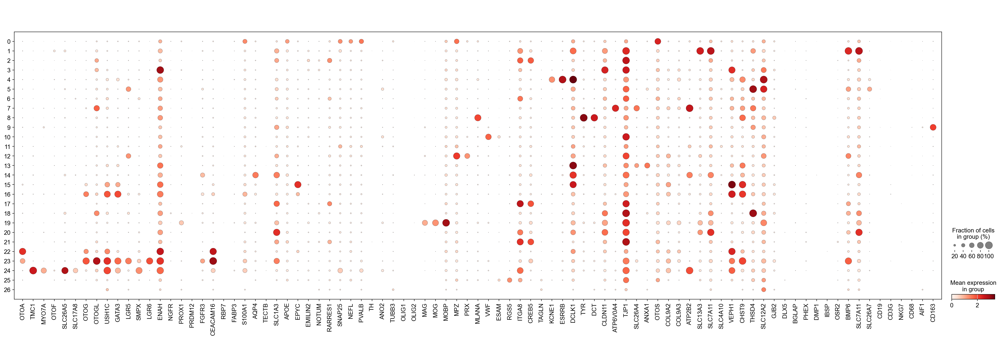

In [304]:
sc.pl.dotplot(adata, marker_genes, groupby="leiden");

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


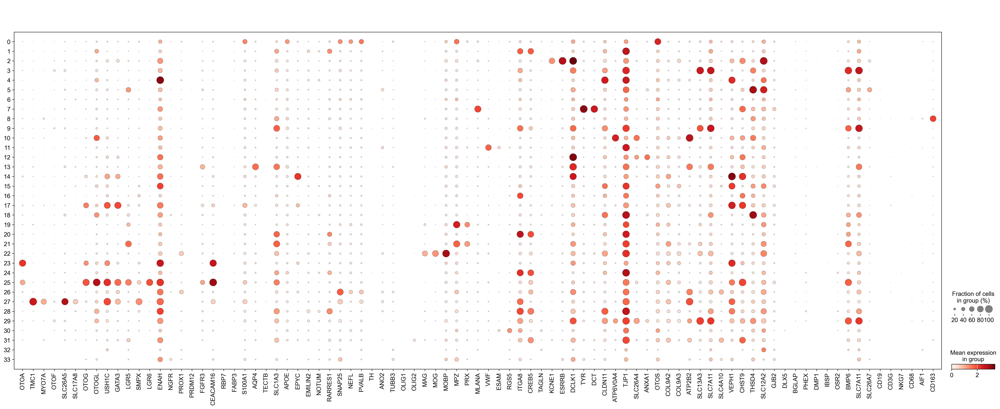

In [152]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(adata, marker_genes, groupby="leiden",
              save=".pdf");


In [153]:
adata

AnnData object with n_obs × n_vars = 9596 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca', 'paga', 'leiden_sizes', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [420]:
macaque_cochlea_1y

AnnData object with n_obs × n_vars = 9596 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [421]:
macaque_1y_clean=adata.obs.leiden.isin(["2","3","5","7","8","9","10","11","12","13","14","17","18","19","21","22","23","25","26",
                                       "27","28","29","30"])

In [422]:
macaque_1y_clean

AAACCCAAGCAATTCC-1     True
AAACCCAAGTATGCAA-1     True
AAACCCACAAGTTCGT-1     True
AAACCCACAGAAGCTG-1     True
AAACCCACAGGGTCTC-1     True
                      ...  
TTTGTTGGTACGTTCA-1     True
TTTGTTGGTAGGACCA-1    False
TTTGTTGGTGACACAG-1     True
TTTGTTGGTGCCGAAA-1    False
TTTGTTGGTTATGTGC-1    False
Name: leiden, Length: 5666, dtype: bool

In [172]:
adata_sub = adata[adata.obs['leiden'].isin(["2","3","5","7","8","9","10","11","12","14","17","18","19","21","22","23","25","26",
                                       "27","28","29","30"])]

In [423]:
macaque_cochlea_1y_sub = macaque_cochlea_1y[macaque_cochlea_1y.obs['leiden'].isin(["2","3","5","7","8","9","10","11","12","14","17","18","19","21","22","23","25","26",
                                       "27","28","29","30"])]

In [173]:
adata_sub

View of AnnData object with n_obs × n_vars = 5666 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca', 'paga', 'leiden_sizes', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [424]:
macaque_cochlea_1y_sub

View of AnnData object with n_obs × n_vars = 5666 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


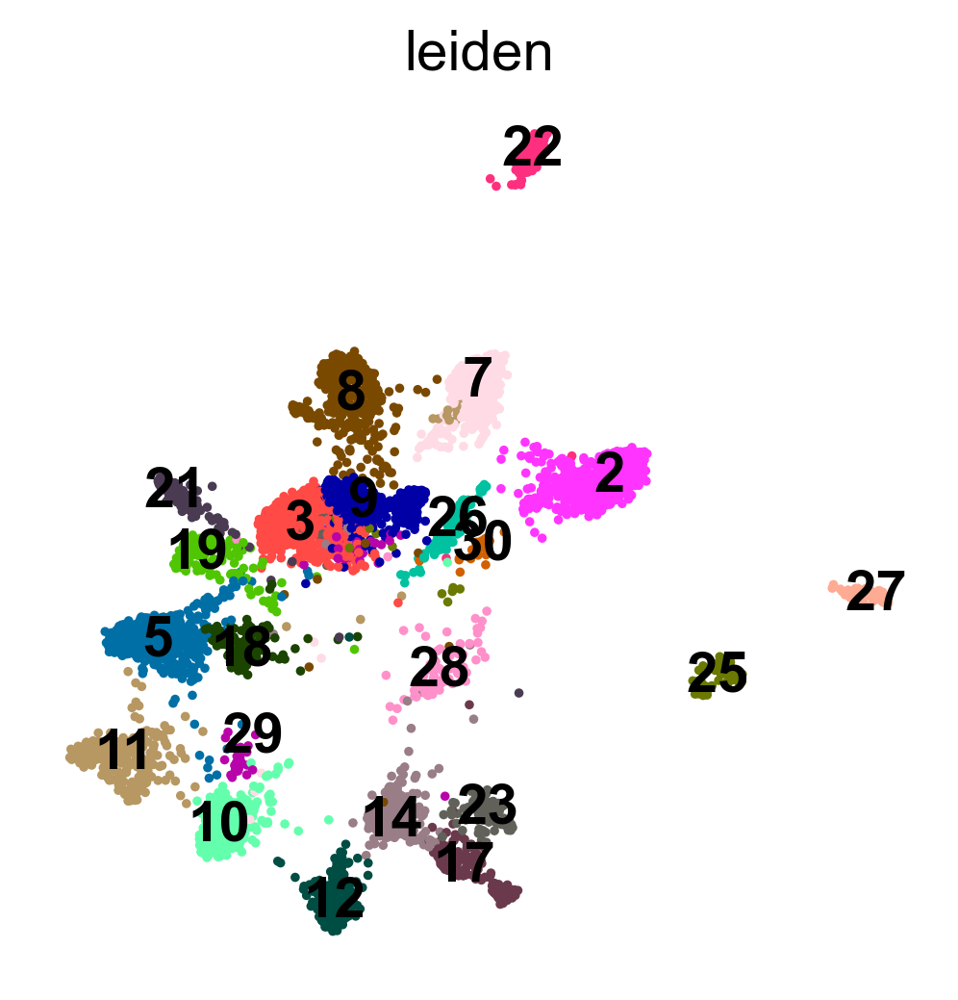

In [174]:
sc.pl.umap(adata_sub, color=['leiden'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


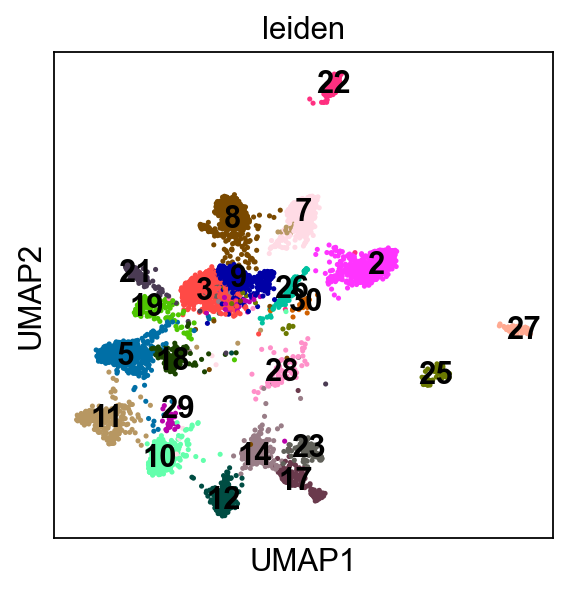

In [425]:
sc.pl.umap(macaque_cochlea_1y_sub, color=['leiden'],legend_loc="on data")

In [175]:
adata_sub

View of AnnData object with n_obs × n_vars = 5666 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca', 'paga', 'leiden_sizes', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [186]:
sc.tl.umap(adata_sub,min_dist=0.6,alpha=0.5, gamma=0.5)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


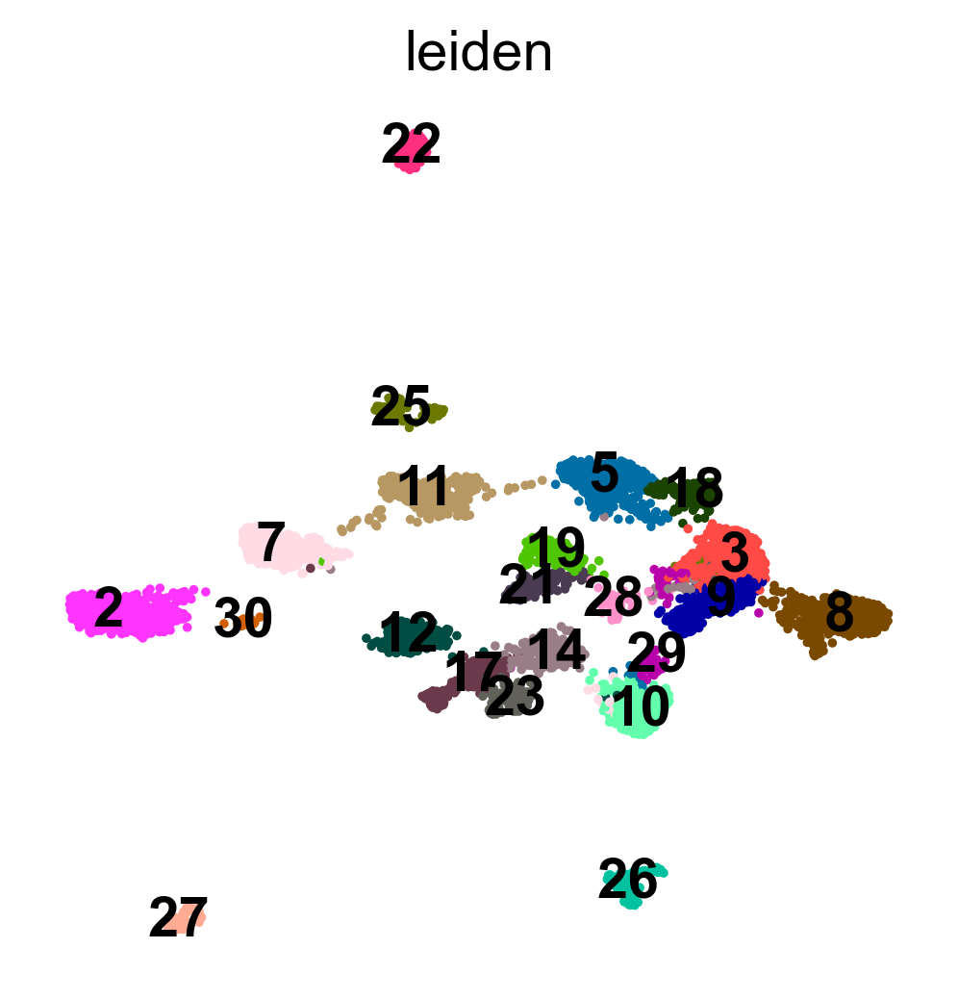

In [187]:
sc.pl.umap(adata_sub,color=["leiden"],legend_loc="on data")

In [193]:
adata_sub.obs["cluster"]=adata_sub.obs["leiden"]

In [426]:
macaque_cochlea_1y_sub.obs["cluster"]=macaque_cochlea_1y_sub.obs["leiden"]

C:\Users\Dell\AppData\Local\Temp\ipykernel_12740\3215530564.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  macaque_cochlea_1y_sub.obs["cluster"]=macaque_cochlea_1y_sub.obs["leiden"]


G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


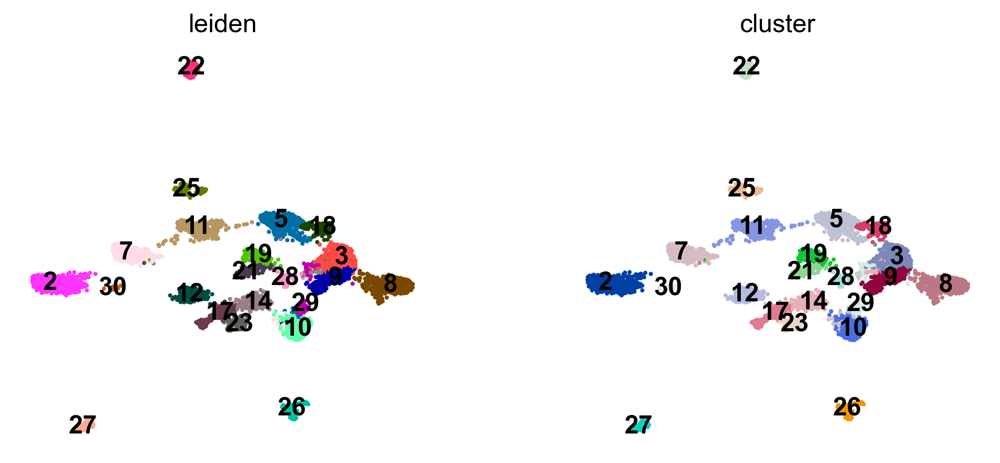

In [194]:
sc.pl.umap(adata_sub,color=["leiden","cluster"],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


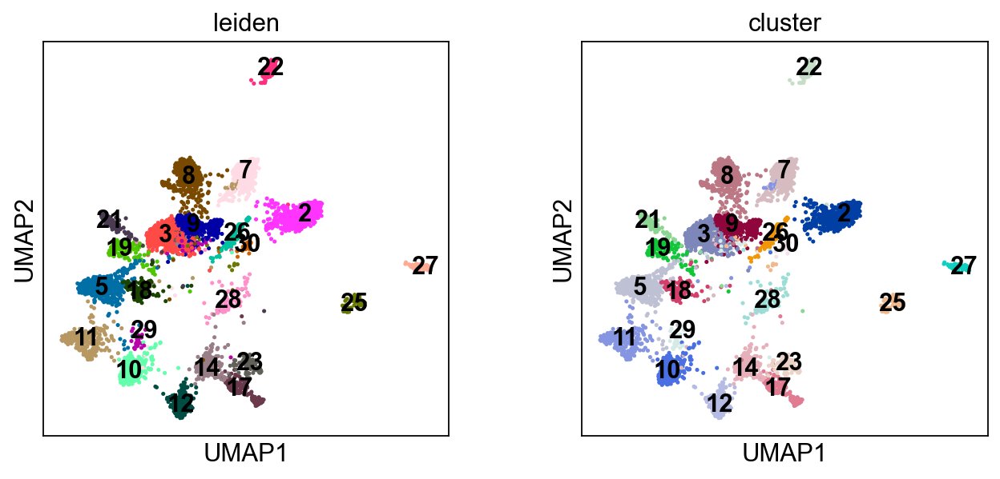

In [427]:
sc.pl.umap(macaque_cochlea_1y_sub,color=["leiden","cluster"],legend_loc="on data")

In [203]:
sc.pp.neighbors(adata_sub, n_neighbors=50, n_pcs=50)
sc.tl.leiden(adata_sub)

In [428]:
sc.pp.neighbors(macaque_cochlea_1y_sub, n_neighbors=50, n_pcs=50)
sc.tl.leiden(macaque_cochlea_1y_sub)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


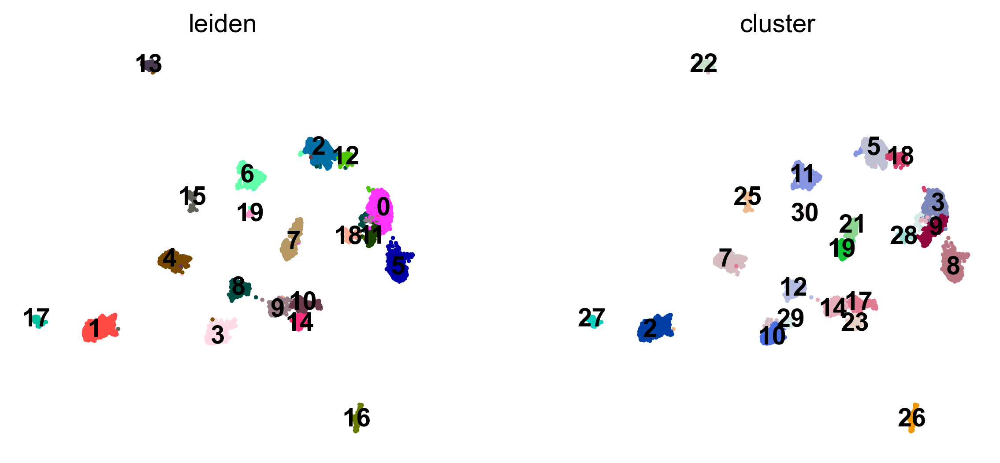

In [204]:
sc.pl.umap(adata_sub,color=["leiden","cluster"],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


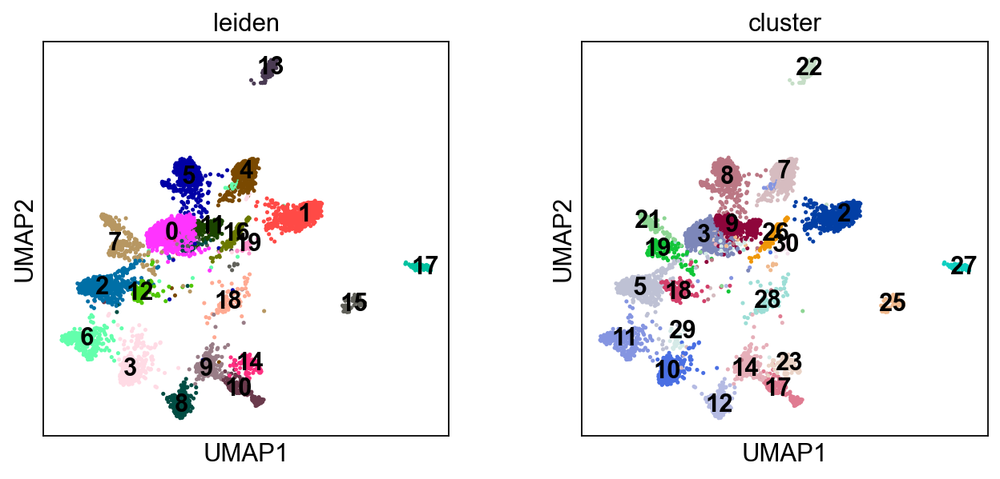

In [429]:
sc.pl.umap(macaque_cochlea_1y_sub,color=["leiden","cluster"],legend_loc="on data")

In [263]:
adata_sub.layers["scaled"]=sc.pp.scale(adata_sub.X,max_value=10,copy=True)
adata_sub.obsm["X_pca"]=sc.pp.pca(adata_sub[:,adata_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata_sub,n_neighbors=50,n_pcs=50,metric="cosine")
sc.tl.umap(adata_sub)
sc.tl.leiden(adata_sub,resolution=2,key_added='cluster2')

In [430]:
macaque_cochlea_1y_sub.layers["scaled"]=sc.pp.scale(macaque_cochlea_1y_sub.X,max_value=10,copy=True)
macaque_cochlea_1y_sub.obsm["X_pca"]=sc.pp.pca(macaque_cochlea_1y_sub[:,macaque_cochlea_1y_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(macaque_cochlea_1y_sub,n_neighbors=50,n_pcs=50,metric="cosine")
sc.tl.umap(macaque_cochlea_1y_sub)
sc.tl.leiden(macaque_cochlea_1y_sub,resolution=2,key_added='cluster2')

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


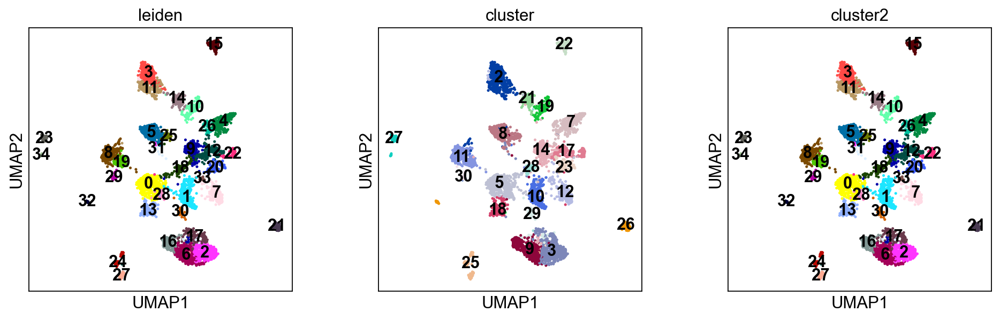

In [321]:
sc.pl.umap(adata_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


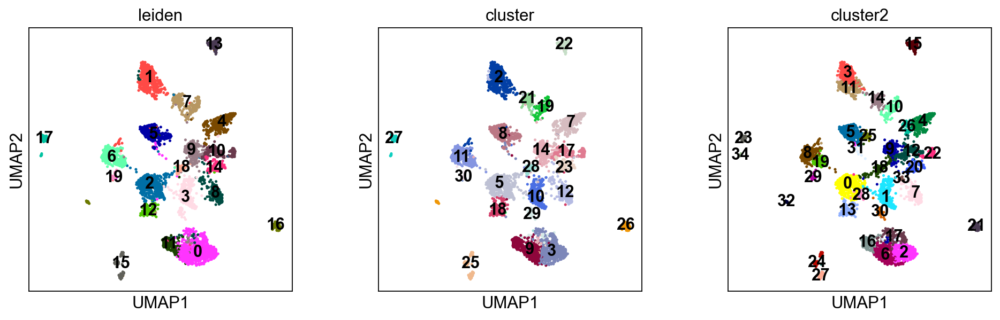

In [431]:
sc.pl.umap(macaque_cochlea_1y_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


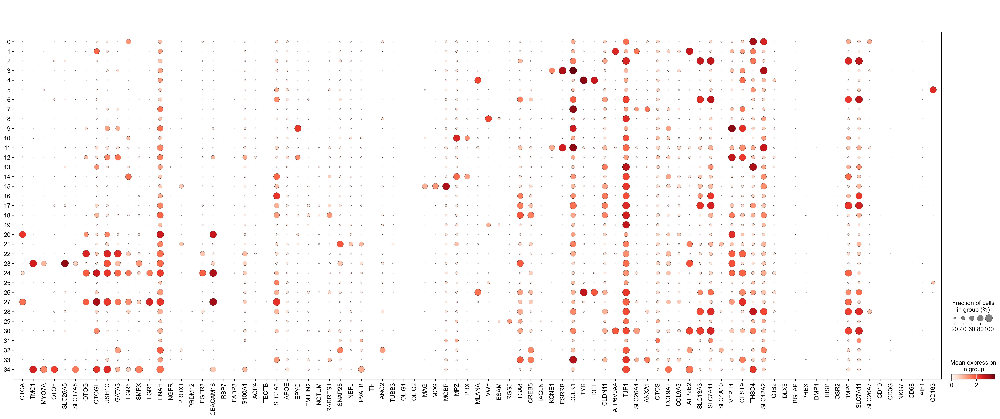

In [230]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(adata_sub, marker_genes, groupby="leiden",
              save="new_recluster.pdf");


G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


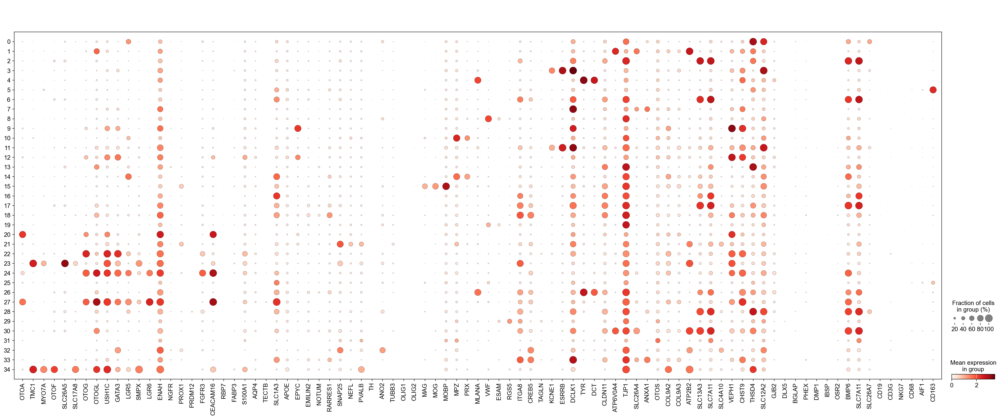

In [432]:
sc.pl.dotplot(macaque_cochlea_1y_sub, marker_genes, groupby="cluster2"
              );

In [294]:
adata_sub2= adata_sub[adata_sub.obs['cluster2'].isin(["0","1","2","3","4","5","6","7","8","9","10","11","12","13","14","15","16","17",
                                       "18","19","20","21","22","23","24","25","26","27","28","29","30","32","34"])]

In [433]:
macaque_cochlea_1y_sub2= macaque_cochlea_1y_sub[macaque_cochlea_1y_sub.obs['cluster2'].isin(["0","1","2","3","4","5","6","7","8","9","10","11","12","13","14","15","16","17",
                                       "18","19","20","21","22","23","24","25","26","27","28","29","30","32","34"])]

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


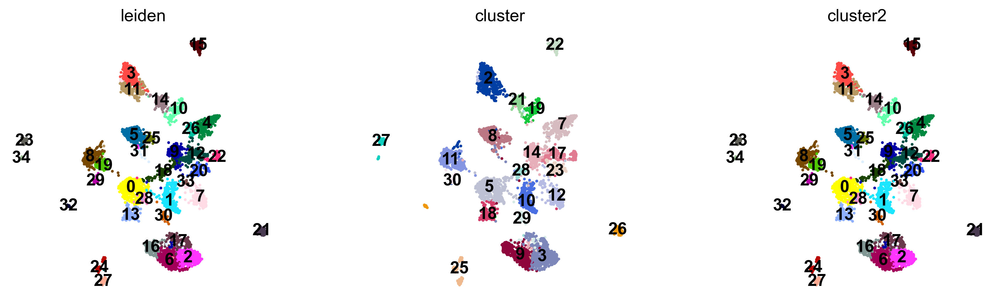

In [279]:
sc.pl.umap(adata_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


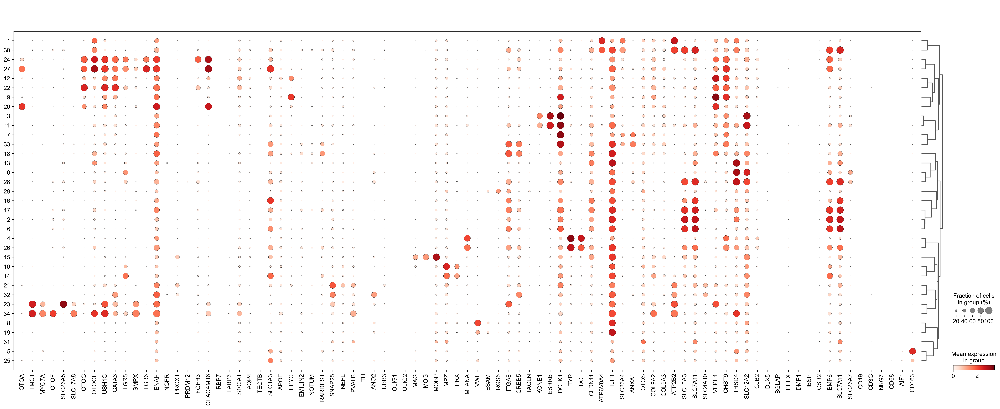

In [278]:
sc.pl.dotplot(adata_sub, marker_genes, groupby="cluster2",
             dendrogram=True)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\tools\_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


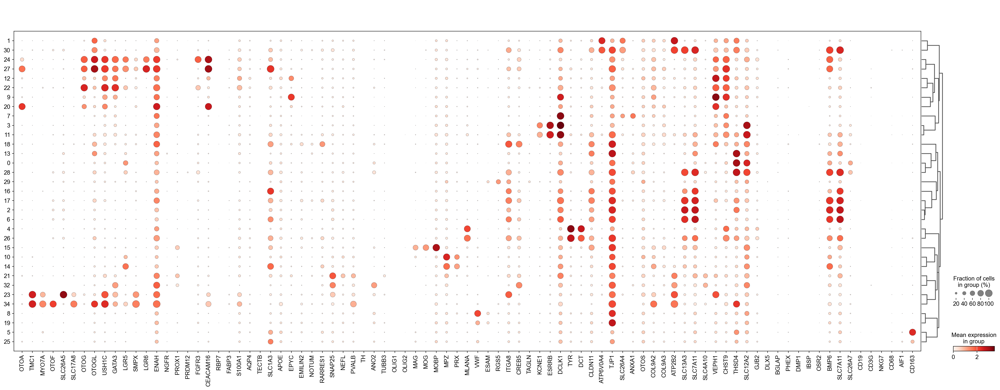

In [434]:
sc.pl.dotplot(macaque_cochlea_1y_sub2, marker_genes, groupby="cluster2",
             dendrogram=True)

In [435]:
cluster_annotation = {
    '0': '5.Fb',
    '1': '1.Bs',
    '2': '5.Fb',
    '3': '10.Ms',
    '4': '9.Is',
    '5': '19.macrophages',
    '6': '5.Fb',
    '7': '15.Sp/Rt',
    '8': '4.Endo.Cells',
    '9': '2.CC_ISC_OSC',
    '10': '14.Schwann.Cells',
    '11': '10.Ms',
    '12': '6.IBC_IPh_HeC',
    '13': '5.Fb',
    '14': '14.Schwann.Cells',
    '15': '13.Satellite.glial.cells',
    '16': '5.Fb',
    '17': '5.Fb',
    '18': '16.TBC',
    '19': '4.Endo.Cells',
    '20': '7.IDC',
    '21': '17.TypeI_SGN',
    '22': '6.IBC_IPh_HeC',
    '23': '11.OHC',
    '24': '3.DC',
    '25': '19.macrophages',
    '26': '9.Is',
    '27': '12.PC',
    '28': '5.Fb',
    '29': '20.pericytes',
    '30': '1.Bs',
    '31': '19.macrophages',
    '32': '18.TypeII_SGN',
    '33': '9.Is',
    '34': '8.IHC',
}
adata_sub.obs['cell_type'] = adata_sub.obs['cluster2'].map(cluster_annotation).astype('category')


G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


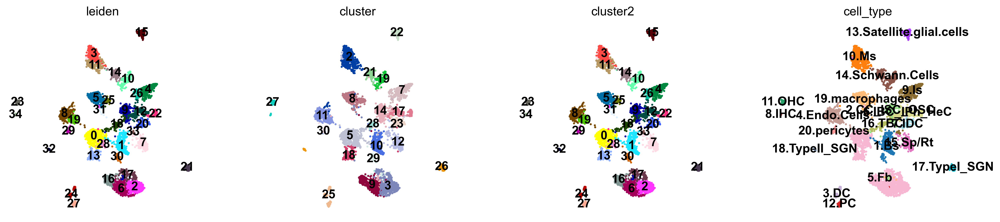

In [369]:
sc.pl.umap(adata_sub,color=["leiden","cluster",'cluster2','cell_type'],legend_loc="on data")

In [8]:
cluster_annotation2 = {
    '0': '5.Fb',
    '1': '1.Bs',
    '2': '5.Fb',
    '3': '10.Ms',
    '4': '9.Is',
    '5': '19.macrophages',
    '6': '5.Fb',
    '7': '15.Sp/Rt',
    '8': '4.Endo.Cells',
    '9': '2.CC_ISC_OSC',
    '10': '14.Schwann.Cells',
    '11': '10.Ms',
    '12': '6.IBC_IPh_HeC',
    '13': '5.Fb',
    '14': '14.Schwann.Cells',
    '15': '13.Satellite.glial.cells',
    '16': '5.Fb',
    '17': '5.Fb',
    '18': '16.TBC',
    '19': '4.Endo.Cells',
    '20': '7.IDC',
    '21': '17.TypeI_SGN',
    '22': '6.IBC_IPh_HeC',
    '23': '11.OHC',
    '24': '3.DC',
    '25': '19.macrophages',
    '26': '9.Is',
    '27': '12.PC',
    '28': '5.Fb',
    '29': '20.pericytes',
    '30': '1.Bs',
    '31': '19.macrophages',
    '32': '18.TypeII_SGN',
    '33': '9.Is',
    '34': '8.IHC',
}

In [437]:
macaque_cochlea_1y_sub2.obs['cell_type2'] = macaque_cochlea_1y_sub2.obs['cluster2'].map(cluster_annotation).astype('category')

In [9]:
macaque_cochlea_1y_new.obs['cell_type2'] = macaque_cochlea_1y_new.obs['cluster2'].map(cluster_annotation2).astype('category')

In [371]:
adata_sub.obs['cell_type']

AAACCCAAGCAATTCC-1        15.Sp/Rt
AAACCCAAGTATGCAA-1    2.CC_ISC_OSC
AAACCCACAAGTTCGT-1          16.TBC
AAACCCACAGAAGCTG-1            5.Fb
AAACCCACAGGGTCTC-1           7.IDC
                          ...     
TTTGTTGGTACGTTCA-1            5.Fb
TTTGTTGGTAGGACCA-1    4.Endo.Cells
TTTGTTGGTGACACAG-1            5.Fb
TTTGTTGGTGCCGAAA-1           10.Ms
TTTGTTGGTTATGTGC-1    4.Endo.Cells
Name: cell_type, Length: 5666, dtype: category
Categories (20, object): ['1.Bs', '10.Ms', '11.OHC', '12.PC', ..., '6.IBC_IPh_HeC', '7.IDC', '8.IHC', '9.Is']

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


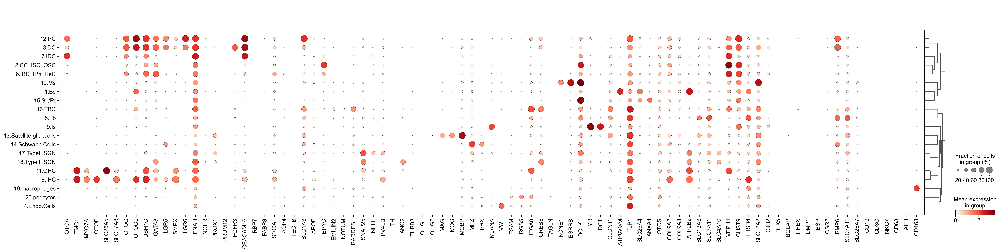

In [438]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(macaque_cochlea_1y_sub2, marker_genes, groupby="cell_type2",
             dendrogram=True,save="cochlea-cell_type_macaque_1y_raw.pdf")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


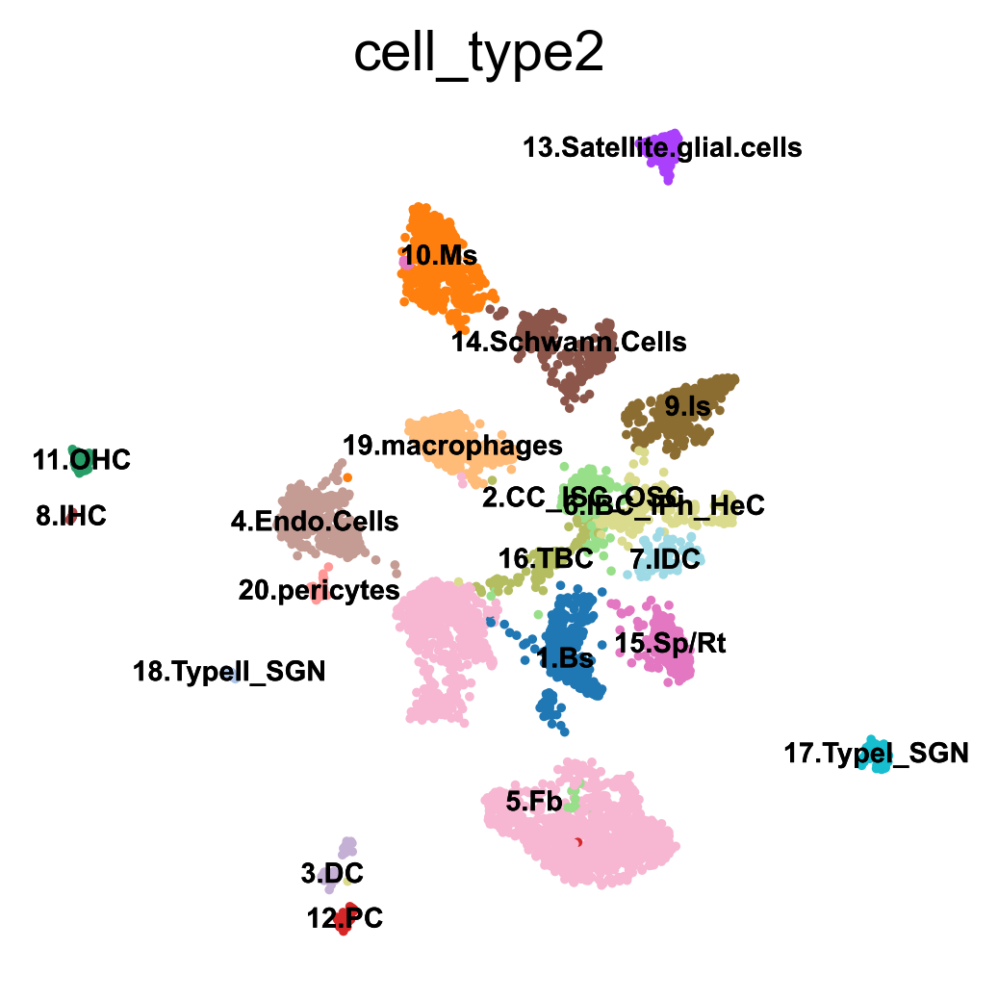

In [439]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_1y_sub2,color='cell_type2',legend_loc='on data',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="macaque_1y-2.pdf")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


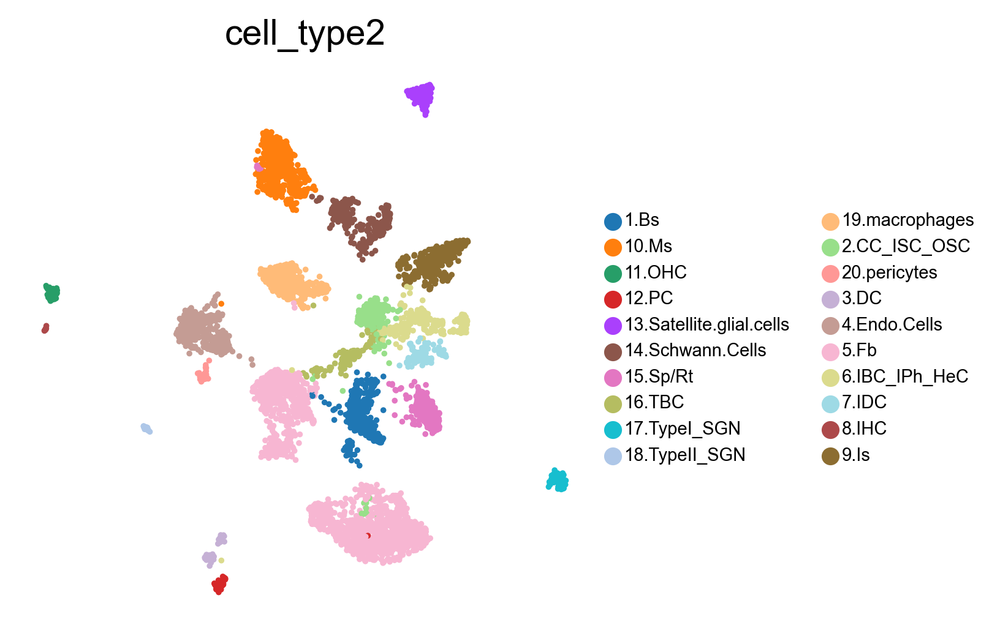

In [440]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_1y_sub2,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="macaque_1y.pdf")

In [333]:
macaque_cochlea_1y_sub2.write("macaque_cochlea_1y_cell-type-annotation.h5ad")

In [3]:
import scanpy as sc
#import scFates as scf
sc.set_figure_params()
macaque_cochlea_1y_new=sc.read("macaque_cochlea_1y_cell-type-annotation.h5ad")

In [4]:
marker_genes_refined = [
    *["OTOA"], #INTERDENTAL CELLS
    *["TMC1","MYO7A","OTOF","SLC26A5","SLC17A8","CALB1"],#HAIR CELLS
    *["OTOG","OTOGL","USH1C","GATA3","LGR5"],# SUPPORTING CELLS
    *["SMPX","LGR6","ENAH","PROX1"],#PILLAR CELLS
    *["FGFR3"],#PILLAR CELLS, DEITERS' CELLS
    *["CEACAM16","S100A1"],#DEITERS' CELLS
    *["SLC1A3","APOE"],#INNER BOR.-PH./HENSEN'S CELLS
    *["EPYC"],#INNER BOR.-PH./HENSEN'S CELLS; CLAUD./IN.-OUT.SULCUS CELLS 
    *["EMILIN2","NOTUM","RARRES1"], #TYMPANIC BORDER CELLS
    
    *["SNAP25","NEFL","PVALB","PRPH","ANO2",'CALB2'],#SGN
    #*["OLIG1","OLIG2"], #GLIAL PRECURSOR CELLS
    *["MAG","MOG","MOBP"],#SATELLITE GLIAL CELLS
    *["MPZ","PRX"], #SCHWANN CELLS
    *["MLANA"], #LW
    *["VWF"], #ENDO.CELLS
    *["ESAM"],#ENDO.CELLS
    *["RGS5","ITGA8","CREB5"],#PERICYTES
    #*["TAGLN"],#SMOOTH MUSCLE CELLS (ALDN1A2)
    *["KCNE1","ESRRB","DCLK1"],#MARGINAL CELLS
    *["TYR","DCT"],#INTER.STRIA CELLS
    *["CLDN11","ATP6V0A4","TJP1"],#BASAL STRIA CELLS
    *["SLC26A4","ANXA1"],#SPINDLE CELLS; ROOT CELLS

    
    *["OTOS","COL9A2","COL9A3","ATP2B2","SLC13A3","SLC7A11","SLC4A10","VEPH1","CHST9","THSD4"],#FIBROCYTES
    *["SLC12A2","GJB2"],# FIBROCYTES SUBTYPES I TO V
    #*["DLX5","BGLAP","PHEX", "DMP1","IBSP"], #OSTEOBLASTS
    *["BMP6","SLC7A11"], # SURROUNDING STRUCTURES
    *["SLC26A7"], #RM
    
    #*["RHD"], #ERYTHROCYTES
    #*["LY6G"], #NEUTROPHILS
   # *["CD19"], # B CELLS
    #*["CD3G"], #T CELLS   
   # *["NKG7"],  #NK CELLS
   # *["CD68"], #MONOCYTES
    *["AIF1","CD163"],#MACROPHAGES 
    #*["PRSS34"]  #MAST CELLS 

    
]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


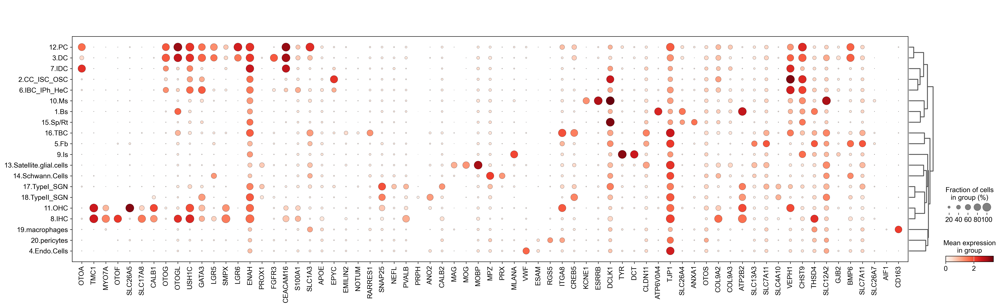

In [13]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(macaque_cochlea_1y_new, marker_genes_refined, groupby="cell_type2",
             dendrogram=True,save="cochlea-cell_type_refined_macaque_1y.pdf")

G:\Miniconda3\envs\coefates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


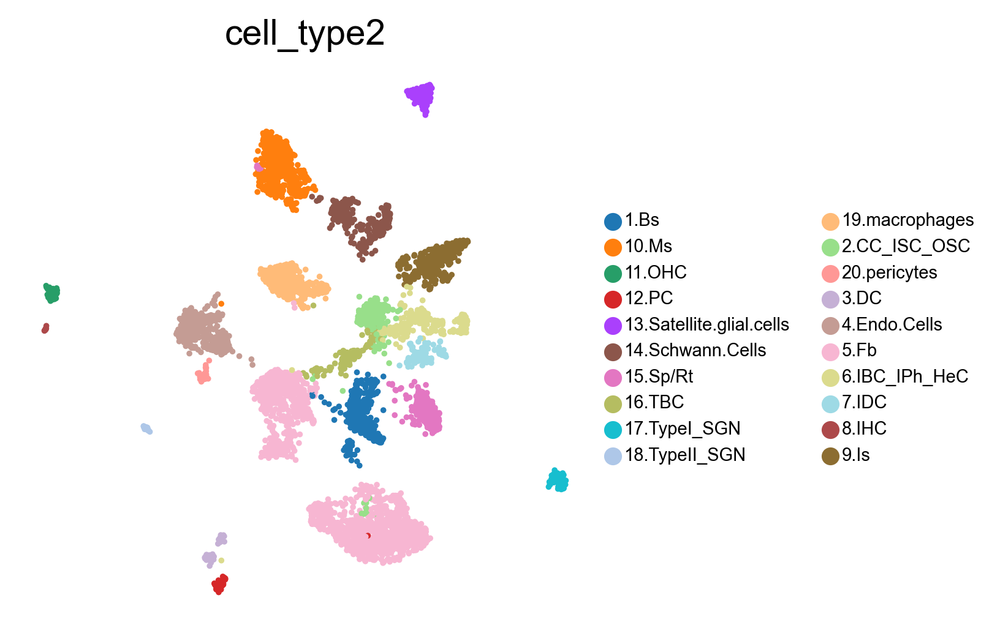

In [11]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_1y_new,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False
         )

G:\Miniconda3\envs\coefates\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


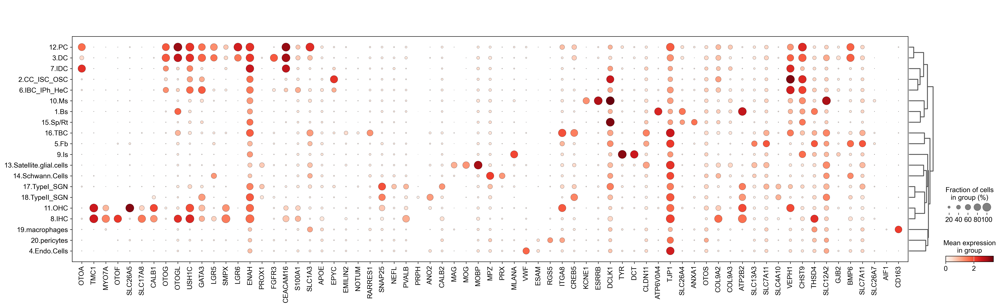

In [12]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(macaque_cochlea_1y_new,groupby="cell_type2")
sc.pl.dotplot(macaque_cochlea_1y_new, marker_genes_refined, groupby="cell_type2",dendrogram=True
             )

In [13]:
small_marker_dict={
'Endo.Cells':['VWF','ESAM'],
'pericytes':['RGS5','ITGA8','CREB5'],
 'macrophages':['AIF1','CD163'],
    'OHC':['TMC1','MYO7A','SLC26A5','CALB1'],
    'IHC':['OTOF','SLC17A8'],
    'TypeII_SGN':['PRPH','ANO2'],
    'TypeI_SGN' :['SNAP25','NEFL','PVALB','CALB2'],
   'Schwann.Cells':['MPZ','PRX'],
'Satellite.glial.cells':['MAG','MOG','MOBP'],
     'Is':['MLANA','TYR','DCT'],
 'Fb':['SLC13A3','SLC7A11','THSD4','SLC12A2','BMP6','SLC7A11','SLC26A7'],
  'TBC':['EMILIN2','NOTUM','RARRES1'],
 'Sp/Rt':['SLC26A4','ANXA1'],
     'Bs':['CLDN11','ATP6V0A4','TJP1'],
 'Ms':['KCNE1','ESRRB','DCLK1'],
 'Pan_SC':['OTOG','OTOGL','USH1C','GATA3'],
   'IBC_IPh_HeC':['S100A1','SLC1A3'],
      'CC_ISC_OSC':['APOE','EPYC'],
    'IDC':['OTOA'],
    'DC':['LGR5','FGFR3','PROX1','CEACAM16'],
    'PC' :['SMPX','LGR6','ENAH'],
    
}
# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in macaque_cochlea_1y_new.var.index:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

In [14]:
smarker_genes_in_data

{'Endo.Cells': ['VWF', 'ESAM'],
 'pericytes': ['RGS5', 'ITGA8', 'CREB5'],
 'macrophages': ['AIF1', 'CD163'],
 'OHC': ['TMC1', 'SLC26A5', 'CALB1'],
 'IHC': ['SLC17A8'],
 'TypeII_SGN': ['ANO2'],
 'TypeI_SGN': ['SNAP25', 'NEFL', 'PVALB', 'CALB2'],
 'Schwann.Cells': ['MPZ', 'PRX'],
 'Satellite.glial.cells': ['MAG', 'MOG', 'MOBP'],
 'Is': ['MLANA', 'TYR', 'DCT'],
 'Fb': ['SLC13A3',
  'SLC7A11',
  'THSD4',
  'SLC12A2',
  'BMP6',
  'SLC7A11',
  'SLC26A7'],
 'TBC': ['RARRES1'],
 'Sp/Rt': ['SLC26A4', 'ANXA1'],
 'Bs': ['CLDN11', 'ATP6V0A4'],
 'Ms': ['ESRRB', 'DCLK1'],
 'Pan_SC': ['OTOG', 'OTOGL', 'USH1C', 'GATA3'],
 'IBC_IPh_HeC': ['S100A1', 'SLC1A3'],
 'CC_ISC_OSC': ['APOE', 'EPYC'],
 'IDC': ['OTOA'],
 'DC': ['LGR5', 'PROX1', 'CEACAM16'],
 'PC': ['SMPX', 'LGR6', 'ENAH']}

categories: 1.Bs, 10.Ms, 11.OHC, etc.
var_group_labels: Endo.Cells, pericytes, macrophages, etc.


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
G:\Miniconda3\envs\scvi-env\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, com

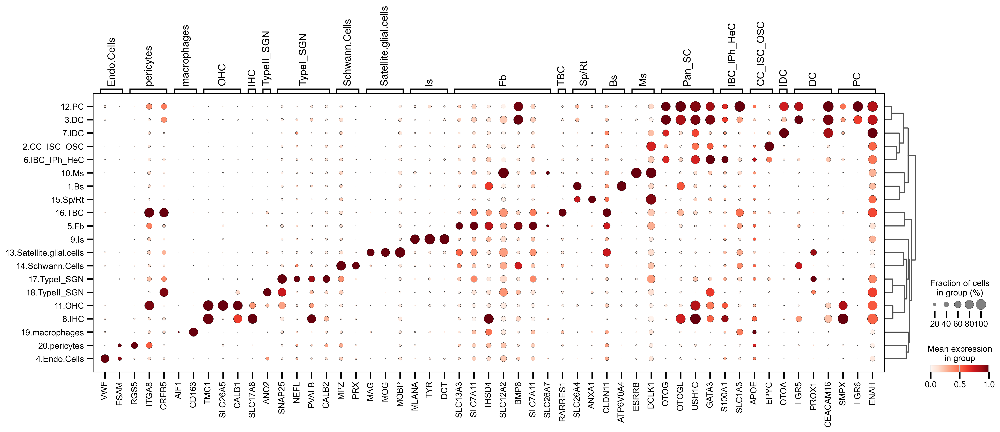

In [279]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    macaque_cochlea_1y_new,
    groupby="cell_type2",
    var_names=smarker_genes_in_data,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    save="cochlea-cell_type_refined_macaque_1y-order.pdf"
)

In [20]:
cluster_annotation2 = {
    '1.Bs': '1.Bs',
    '2.CC_ISC_OSC': '2.CC_ISC_OSC',
    '3.DC': '3.DC',
    '4.Endo.Cells': '4.Endo.Cell',
    '5.Fb': '5.Fb',
    '6.IBC_IPh_HeC': '6.IBC_IPh_HeCs',
    '7.IDC': '7.IDC',
    '8.IHC': '8.IHC',
    '9.Is': '9.Is',
    '10.Ms': '10.Ms',
    '11.OHC': '11.OHC',
    '12.PC': '12.PC',
    '13.Satellite.glial.cells': '13.Satellite.glial.cells',
    '14.Schwann.Cells': '14.Schwann.Cells',
    '15.Sp/Rt': '15.Sp_Rt',
    '16.TBC': '16.TBC',
    '17.TypeI_SGN': '17.TypeI_SGN',
    '18.TypeII_SGN': '18.TypeII_SGN',
    '19.macrophages': '19.macrophages',
    '20.pericytes': '20.pericytes',
   
}

In [21]:
macaque_cochlea_1y_new.obs['cell_type5'] = macaque_cochlea_1y_new.obs['cell_type2'].map(cluster_annotation2).astype('category')

G:\Miniconda3\envs\coefates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


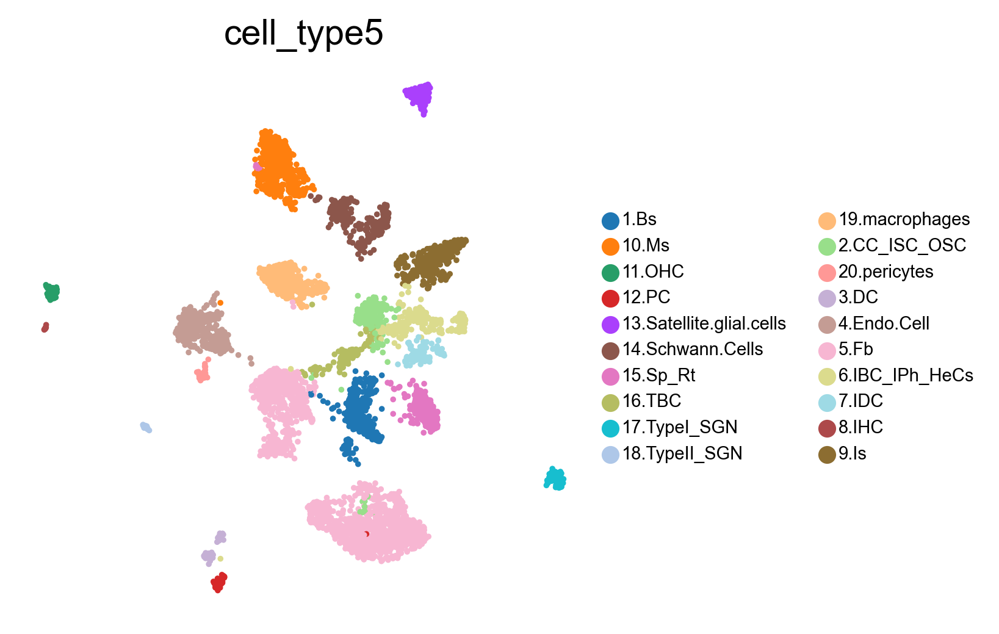

In [22]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_1y_new,color='cell_type5',frameon=False, legend_fontsize=7, legend_fontoutline=False
         )

In [23]:
sc.tl.rank_genes_groups(macaque_cochlea_1y_new,"cell_type5",method="wilcoxon")

In [25]:
from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
writer = pd.ExcelWriter('data/COCHLEA_MACAQUE_DE_1-year.xlsx', engine='xlsxwriter')
for cl in macaque_cochlea_1y_new.obs.cell_type5.cat.categories:
    sc.get.rank_genes_groups_df(macaque_cochlea_1y_new,cl,pval_cutoff=1,log2fc_min=0).set_index("names").to_excel(writer, 
                                                                     sheet_name=cl)
    
writer.save()

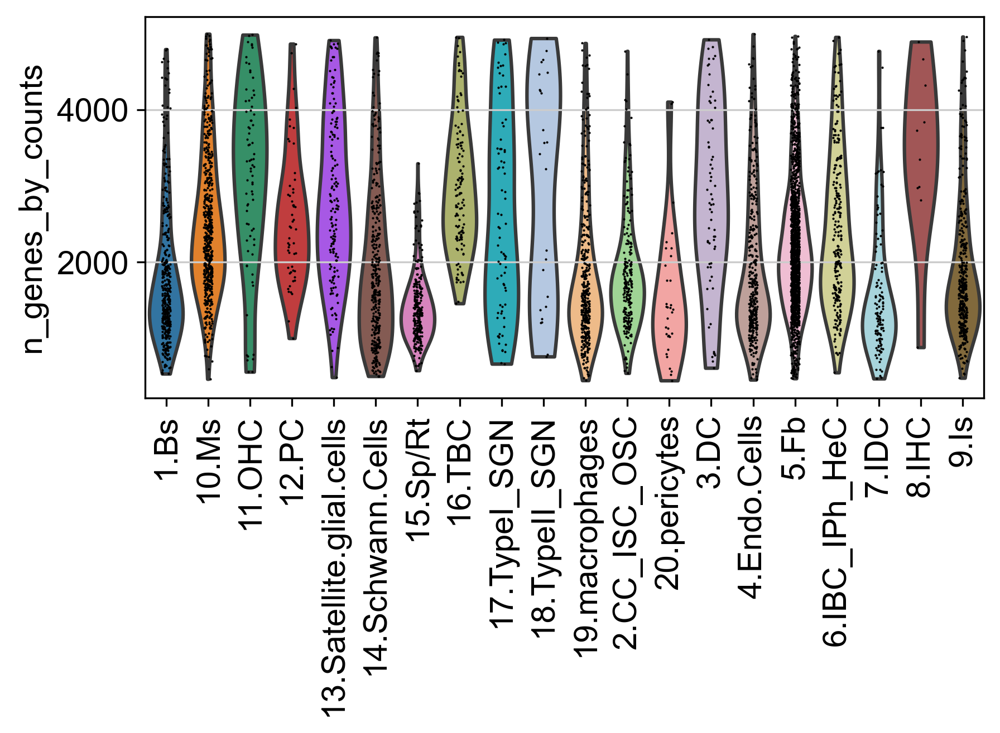

In [446]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(macaque_cochlea_1y_sub2, ['n_genes_by_counts'], groupby='cell_type2',rotation=90)

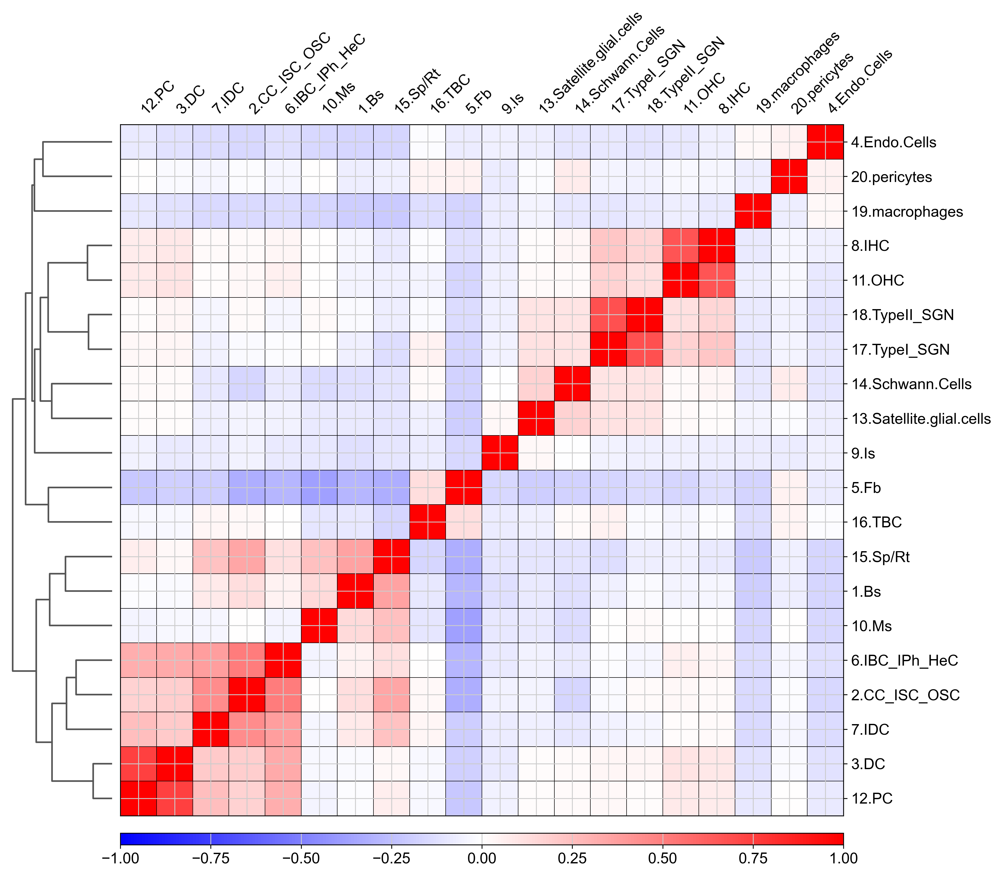

In [447]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.correlation_matrix(macaque_cochlea_1y_sub2, 'cell_type2',
                         save="cell-type-correlation_macaque_1y.pdf")

In [448]:
macaque_cochlea_1y_sub2

AnnData object with n_obs × n_vars = 5619 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_sizes', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2', 'dendrogram_cell_type2', 'cell_type2_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [449]:
cluster_annotation3 = {
    '0': 'Lateral wall (LW)',
    '1': 'Lateral wall (LW)',
    '2': 'Lateral wall (LW)',
    '3': 'Lateral wall (LW)',
    '4': 'Lateral wall (LW)',
    '5': 'macrophages',
    '6': 'Lateral wall (LW)',
    '7': 'Lateral wall (LW)',
    '8': 'Lateral wall (LW)',
    '9': 'Supporting cells (SCs)',
    '10': 'Glia cells (GCs)',
    '11': 'Lateral wall (LW)',
    '12': 'Supporting cells (SCs)',
    '13': 'Lateral wall (LW)',
    '14': 'Glia cells (GCs)',
    '15': 'Glia cells (GCs)',
    '16': 'Lateral wall (LW)',
    '17': 'Lateral wall (LW)',
    '18': 'Supporting cells (SCs)',
    '19': 'Lateral wall (LW)',
    '20': 'Supporting cells (SCs)',
    '21': 'Neurons (Neu)',
    '22': 'Supporting cells (SCs)',
    '23': 'Hair cells (HCs)',
    '24': 'Supporting cells (SCs)',
    '25': 'macrophages',
    '26': 'Lateral wall (LW)',
    '27': 'Supporting cells (SCs)',
    '28': 'Lateral wall (LW)',
    '29': 'Lateral wall (LW)',
    '30': 'Lateral wall (LW)',
    '31': 'macrophages',
    '32': 'Neurons (Neu)',
    '33': 'Lateral wall (LW)',
    '34': 'Hair cells (HCs)',
}

In [450]:
macaque_cochlea_1y_sub2.obs['cell_type3'] = macaque_cochlea_1y_sub2.obs['cluster2'].map(cluster_annotation3).astype('category')

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


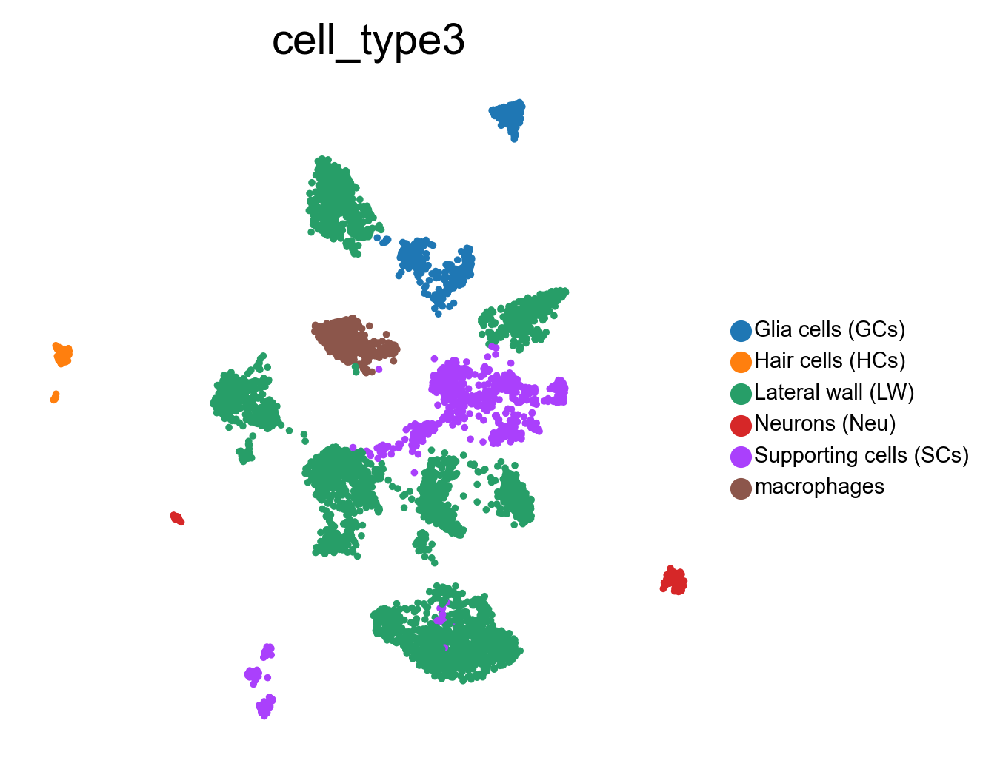

In [451]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_1y_sub2,color='cell_type3',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="macaque_1y_regions.pdf")

In [452]:
macaque_cochlea_1y_sub2

AnnData object with n_obs × n_vars = 5619 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_sizes', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2', 'dendrogram_cell_type2', 'cell_type2_colors', 'cell_type3_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [453]:
macaque_1y_raw=macaque_cochlea_1y_sub2

In [454]:
macaque_1y_raw

AnnData object with n_obs × n_vars = 5619 × 4835
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_sizes', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2', 'dendrogram_cell_type2', 'cell_type2_colors', 'cell_type3_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


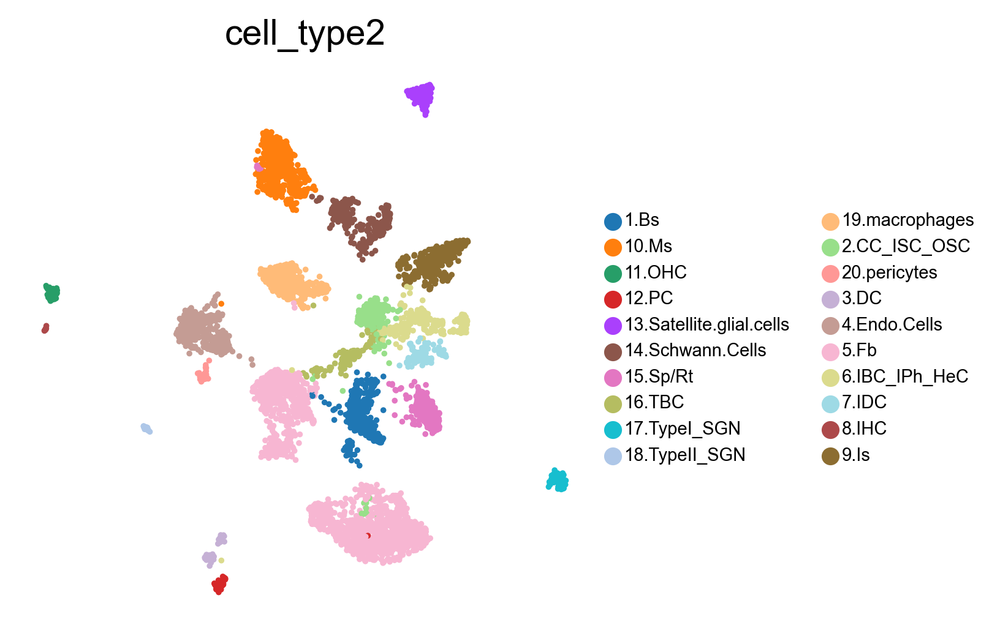

In [457]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_1y_raw,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False
          )

In [465]:
macaque_1y_raw.raw.to_adata()

AnnData object with n_obs × n_vars = 5619 × 25972
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Mt', 'MT', 'HB', 'Hb', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_sizes', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'paga', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2', 'dendrogram_cell_type2', 'cell_type2_colors', 'cell_type3_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [458]:
macaque_1y_raw.write("macaque_1y_raw.h5ad")